In [1]:
import pandas as pd

In [3]:
df_data = pd.read_csv('./mediosDigitales.csv')

In [4]:
df_data.head()

,id,date,month_date,dateHour,deviceCategory,operatingSystem,country,bounceRate,bounces,avgSessionDuration,sessionDuration,pageviews,sessions,users,pageviewsPerSession,uniquePageviews,medio_digital,activate,type_user
0,43507123,2022-05-14,2022-05,02:00:00,desktop,Macintosh,Mexico,0.0,0.0,2.00,2.0,1.0,1,1,1.00,1.0,PORTAFOLIO,0,New Visitor
1,43507267,2022-05-14,2022-05,10:00:00,mobile,Android,Mexico,0.0,0.0,111.00,111.0,3.0,1,1,3.00,1.0,PORTAFOLIO,0,New Visitor
2,43507268,2022-05-14,2022-05,10:00:00,mobile,Android,Mexico,0.0,0.0,205.00,410.0,4.0,2,2,2.00,3.0,PORTAFOLIO,0,Returning Visitor
3,43507312,2022-05-14,2022-05,11:00:00,mobile,Android,Mexico,0.0,0.0,81.86,573.0,9.0,7,7,1.29,7.0,PORTAFOLIO,0,New Visitor
4,43507313,2022-05-14,2022-05,11:00:00,mobile,Android,Mexico,50.0,1.0,3.50,7.0,2.0,2,2,1.00,2.0,PORTAFOLIO,0,Returning Visitor


In [5]:
df_data.describe()

,id,bounceRate,bounces,avgSessionDuration,sessionDuration,pageviews,sessions,users,pageviewsPerSession,uniquePageviews,activate
count,3.213670e+05,321367.000000,321367.000000,321367.000000,321367.000000,321367.000000,321367.000000,321367.000000,321367.000000,321367.000000,321367.000000
mean,8.442798e+07,32.509124,1.256296,73.777134,446.174249,4.554936,3.549307,4.105558,0.861831,3.896172,0.818065
std,3.053032e+07,42.089022,3.379871,214.799321,1539.665086,10.095800,8.137143,8.460691,0.634609,8.623840,0.385792
min,4.309021e+07,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000
25%,5.305179e+07,0.000000,0.000000,0.000000,0.000000,1.000000,1.000000,1.000000,0.000000,1.000000,1.000000
50%,8.425396e+07,0.000000,0.000000,0.120000,1.000000,2.000000,1.000000,1.000000,1.000000,1.000000,1.000000
75%,1.139230e+08,75.535000,1.000000,44.000000,132.000000,5.000000,4.000000,4.000000,1.000000,4.000000,1.000000
max,1.320263e+08,200.000000,145.000000,10850.000000,38295.000000,386.000000,226.000000,234.000000,30.000000,231.000000,1.000000


In [6]:
df_data['medio_digital'].unique()

array(['PORTAFOLIO', 'TIEMPO DIGITAL', 'PUBLIMETRO DIGITAL', 'WIN SPORTS',
       'SEMANA DIGITAL', 'AMBITO JURIDICO'], dtype=object)

In [8]:
import plotly.express as px
fig = px.box(df_data, y="sessions")
fig.show()

In [9]:
fig = px.box(df_data,x='medio_digital', y="sessions")
fig.show()

In [10]:
fig = px.line(df_data, x="date", y="sessions", color='medio_digital')
fig.show()

#### Explicacion tupla,diccionario, lista

In [23]:
# Tupla => no puede ser alterada

tupla1 = (3.141618, 2.71828)
tupla1[1]

# Diccionario => Implementa una llave para realizar busquedas 
empresa = {'empresa': 'exito', 'direccion': 'carrera 45 # 18 - 23', 'telefono': '3112889288399'}
empresa['direccion']

# Lista => puede ingresar diferentes tipos de variables y su contenido puede ser alterado

empresas = [49494, 40404.40404, 'hola mundo', 'ae3ef90034', 
            {'empresa': 'exito', 
             'direccion': 'carrera 45 # 18 - 23', 
             'telefono': '3112889288399'}
            ]
empresas[4]['empresa']

'carrera 45 # 18 - 23'

In [40]:
df_resumen_sessions = df_data.groupby(['month_date','medio_digital']).agg({'month_date': 'first', 
                                                    'medio_digital': 'first',
                                                     'sessions': 'sum'
                                                    })


In [41]:
df_resumen_sessions.columns

Index(['month_date', 'medio_digital', 'sessions'], dtype='object')

In [44]:
fig = px.line(df_resumen_sessions, x='month_date', y='sessions', color='medio_digital', title='comportamiento sessions')
fig.show()

In [45]:
df_resumen_users = df_data.groupby(['month_date','medio_digital']).agg({'month_date': 'first', 
                                                    'medio_digital': 'first',
                                                     'users': 'sum'
                                                    })


In [47]:
fig = px.line(df_resumen_users, x='month_date', y='users', color='medio_digital', title='comportamiento sessions')
fig.show()

In [50]:
df_resumen_bouncerate = df_data.groupby(['month_date','medio_digital']).agg({'month_date': 'first', 
                                                                     'medio_digital': 'first', 
                                                                     'bounces': 'sum',
                                                                     'sessions': 'sum'})

In [57]:
df_resumen_bouncerate['bouncerate'] = df_resumen_bouncerate['sessions']/  df_resumen_bouncerate['bounces']

In [64]:
figura = px.line(df_resumen_bouncerate, x='month_date', y='bouncerate', color='medio_digital') 
figura.show()


In [108]:
df_resumen_diveceCategory = df_data.groupby(['medio_digital','deviceCategory']).agg({'medio_digital': 'first',
                                                                                    'deviceCategory': 'first',
                                                                                    'sessions': 'sum'})

In [109]:
import plotly.graph_objects as go
from plotly.subplots import make_subplots

labels = df_resumen_diveceCategory['deviceCategory'].unique()

# Create subplots: use 'domain' type for Pie subplot
fig = make_subplots(rows=2, cols=3, specs=[[{'type':'domain'}, {'type':'domain'} , {'type':'domain'}],
                                           [{'type':'domain'}, {'type':'domain'} , {'type':'domain'}]])

fig.add_trace(go.Pie(labels=labels, 
                     values=df_resumen_diveceCategory['sessions'][df_resumen_diveceCategory['medio_digital'] == 'AMBITO JURIDICO'], 
                     name="AMBITO JURIDICO"),
              1, 1)
#['AMBITO JURIDICO', 'PORTAFOLIO', 'PUBLIMETRO DIGITAL',
#       'SEMANA DIGITAL', 'TIEMPO DIGITAL', 'WIN SPORTS']
    
fig.add_trace(go.Pie(labels=labels, 
                     values=df_resumen_diveceCategory['sessions'][df_resumen_diveceCategory['medio_digital'] == 'PORTAFOLIO'], 
                     name="PORTAFOLIO"),
              1, 2)
fig.add_trace(go.Pie(labels=labels, 
                     values=df_resumen_diveceCategory['sessions'][df_resumen_diveceCategory['medio_digital'] == 'PUBLIMETRO DIGITAL'], 
                     name="PUBLIMETRO DIGITAL"),
              1, 3)

fig.add_trace(go.Pie(labels=labels, 
                     values=df_resumen_diveceCategory['sessions'][df_resumen_diveceCategory['medio_digital'] == 'SEMANA DIGITAL'], 
                     name="SEMANA DIGITAL"),
              2, 1)
fig.add_trace(go.Pie(labels=labels, 
                     values=df_resumen_diveceCategory['sessions'][df_resumen_diveceCategory['medio_digital'] == 'TIEMPO DIGITAL'], 
                     name="TIEMPO DIGITAL"),
              2, 2)
fig.add_trace(go.Pie(labels=labels, 
                     values=df_resumen_diveceCategory['sessions'][df_resumen_diveceCategory['medio_digital'] == 'WIN SPORTS'], 
                     name="WIN SPORTS"),
              2, 3)

# Use `hole` to create a donut-like pie chart
fig.update_traces(hole=.4, hoverinfo="label+percent+name")

fig.update_layout(
    title_text="Device Category per Medio Digital",
#    # Add annotations in the center of the donut pies.
    annotations=[dict(text='AB', x=0.12, y=0.83, font_size=20, showarrow=False),
                 dict(text='POR', x=0.5, y=0.83, font_size=20, showarrow=False),
                 dict(text='PD', x=0.88, y=0.83, font_size=20, showarrow=False),
                 dict(text='SD', x=0.12, y=0.17, font_size=20, showarrow=False),
                 dict(text='TD', x=0.5, y=0.17, font_size=20, showarrow=False),
                 dict(text='WS', x=0.88, y=0.17, font_size=20, showarrow=False),
                ])
fig.show()

In [112]:
df_resumen_operatingSystem = df_data[df_data['deviceCategory'] == 'mobile'].groupby(['medio_digital','operatingSystem']).agg({'medio_digital': 'first',
                                                                                        'operatingSystem': 'first',
                                                                                        'sessions': 'sum'})

In [115]:
labels = df_resumen_operatingSystem['operatingSystem'].unique()

# Create subplots: use 'domain' type for Pie subplot
fig = make_subplots(rows=2, cols=3, specs=[[{'type':'domain'}, {'type':'domain'} , {'type':'domain'}],
                                           [{'type':'domain'}, {'type':'domain'} , {'type':'domain'}]])

fig.add_trace(go.Pie(labels=labels, 
                     values=df_resumen_operatingSystem['sessions'][df_resumen_operatingSystem['medio_digital'] == 'AMBITO JURIDICO'], 
                     name="AMBITO JURIDICO"),
              1, 1)
#['AMBITO JURIDICO', 'PORTAFOLIO', 'PUBLIMETRO DIGITAL',
#       'SEMANA DIGITAL', 'TIEMPO DIGITAL', 'WIN SPORTS']
    
fig.add_trace(go.Pie(labels=labels, 
                     values=df_resumen_operatingSystem['sessions'][df_resumen_operatingSystem['medio_digital'] == 'PORTAFOLIO'], 
                     name="PORTAFOLIO"),
              1, 2)
fig.add_trace(go.Pie(labels=labels, 
                     values=df_resumen_operatingSystem['sessions'][df_resumen_operatingSystem['medio_digital'] == 'PUBLIMETRO DIGITAL'], 
                     name="PUBLIMETRO DIGITAL"),
              1, 3)

fig.add_trace(go.Pie(labels=labels, 
                     values=df_resumen_operatingSystem['sessions'][df_resumen_operatingSystem['medio_digital'] == 'SEMANA DIGITAL'], 
                     name="SEMANA DIGITAL"),
              2, 1)
fig.add_trace(go.Pie(labels=labels, 
                     values=df_resumen_operatingSystem['sessions'][df_resumen_operatingSystem['medio_digital'] == 'TIEMPO DIGITAL'], 
                     name="TIEMPO DIGITAL"),
              2, 2)
fig.add_trace(go.Pie(labels=labels, 
                     values=df_resumen_operatingSystem['sessions'][df_resumen_operatingSystem['medio_digital'] == 'WIN SPORTS'], 
                     name="WIN SPORTS"),
              2, 3)

# Use `hole` to create a donut-like pie chart
fig.update_traces(hole=.4, hoverinfo="label+percent+name")

fig.update_layout(
    title_text="Device Category per Medio Digital",
#    # Add annotations in the center of the donut pies.
    annotations=[dict(text='AB', x=0.12, y=0.83, font_size=20, showarrow=False),
                 dict(text='POR', x=0.5, y=0.83, font_size=20, showarrow=False),
                 dict(text='PD', x=0.88, y=0.83, font_size=20, showarrow=False),
                 dict(text='SD', x=0.12, y=0.17, font_size=20, showarrow=False),
                 dict(text='TD', x=0.5, y=0.17, font_size=20, showarrow=False),
                 dict(text='WS', x=0.88, y=0.17, font_size=20, showarrow=False),
                ])
fig.show()

#### CORRELACION DE VARIABLES

In [116]:
correlacion = df_data.corr()

In [117]:
correlacion

,id,bounceRate,bounces,avgSessionDuration,sessionDuration,pageviews,sessions,users,pageviewsPerSession,uniquePageviews,activate
id,1.000000,0.271354,0.181471,0.022888,0.031591,0.004064,0.009143,0.007459,-0.027961,0.012234,-0.008709
bounceRate,0.271354,1.000000,0.358812,-0.155804,-0.092426,-0.012583,0.029903,-0.014370,0.254292,0.007854,-0.065142
bounces,0.181471,0.358812,1.000000,-0.010376,0.269876,0.552755,0.602413,0.574635,0.160581,0.589096,0.040870
avgSessionDuration,0.022888,-0.155804,-0.010376,1.000000,0.446695,0.122814,0.105453,0.093447,0.307660,0.099211,0.018989
sessionDuration,0.031591,-0.092426,0.269876,0.446695,1.000000,0.685656,0.667815,0.664622,0.222922,0.665769,0.070260
pageviews,0.004064,-0.012583,0.552755,0.122814,0.685656,1.000000,0.962279,0.980993,0.245532,0.985999,0.048634
sessions,0.009143,0.029903,0.602413,0.105453,0.667815,0.962279,1.000000,0.972707,0.232159,0.975165,0.057237
users,0.007459,-0.014370,0.574635,0.093447,0.664622,0.980993,0.972707,1.000000,0.165105,0.993293,0.067141
pageviewsPerSession,-0.027961,0.254292,0.160581,0.307660,0.222922,0.245532,0.232159,0.165105,1.000000,0.202687,-0.113146
uniquePageviews,0.012234,0.007854,0.589096,0.099211,0.665769,0.985999,0.975165,0.993293,0.202687,1.000000,0.059530


In [118]:
import matplotlib.pyplot as plt

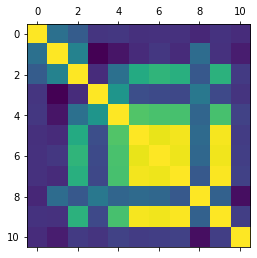

In [119]:
plt.matshow(correlacion)

In [120]:
correlacion

,id,bounceRate,bounces,avgSessionDuration,sessionDuration,pageviews,sessions,users,pageviewsPerSession,uniquePageviews,activate
id,1.000000,0.271354,0.181471,0.022888,0.031591,0.004064,0.009143,0.007459,-0.027961,0.012234,-0.008709
bounceRate,0.271354,1.000000,0.358812,-0.155804,-0.092426,-0.012583,0.029903,-0.014370,0.254292,0.007854,-0.065142
bounces,0.181471,0.358812,1.000000,-0.010376,0.269876,0.552755,0.602413,0.574635,0.160581,0.589096,0.040870
avgSessionDuration,0.022888,-0.155804,-0.010376,1.000000,0.446695,0.122814,0.105453,0.093447,0.307660,0.099211,0.018989
sessionDuration,0.031591,-0.092426,0.269876,0.446695,1.000000,0.685656,0.667815,0.664622,0.222922,0.665769,0.070260
pageviews,0.004064,-0.012583,0.552755,0.122814,0.685656,1.000000,0.962279,0.980993,0.245532,0.985999,0.048634
sessions,0.009143,0.029903,0.602413,0.105453,0.667815,0.962279,1.000000,0.972707,0.232159,0.975165,0.057237
users,0.007459,-0.014370,0.574635,0.093447,0.664622,0.980993,0.972707,1.000000,0.165105,0.993293,0.067141
pageviewsPerSession,-0.027961,0.254292,0.160581,0.307660,0.222922,0.245532,0.232159,0.165105,1.000000,0.202687,-0.113146
uniquePageviews,0.012234,0.007854,0.589096,0.099211,0.665769,0.985999,0.975165,0.993293,0.202687,1.000000,0.059530


In [121]:
df_data_cluster = df_data[['medio_digital', 'bounces', 'sessionDuration', 'pageviews', 'sessions',
                          'users','pageviewsPerSession','uniquePageviews']]

In [122]:
df_data_cluster

,medio_digital,bounces,sessionDuration,pageviews,sessions,users,pageviewsPerSession,uniquePageviews
0,PORTAFOLIO,0.0,2.0,1.0,1,1,1.00,1.0
1,PORTAFOLIO,0.0,111.0,3.0,1,1,3.00,1.0
2,PORTAFOLIO,0.0,410.0,4.0,2,2,2.00,3.0
3,PORTAFOLIO,0.0,573.0,9.0,7,7,1.29,7.0
4,PORTAFOLIO,1.0,7.0,2.0,2,2,1.00,2.0
...,...,...,...,...,...,...,...,...
321362,AMBITO JURIDICO,2.0,1357.0,4.0,3,3,1.33,3.0
321363,AMBITO JURIDICO,1.0,0.0,1.0,1,1,1.00,1.0
321364,AMBITO JURIDICO,3.0,0.0,3.0,3,3,1.00,3.0
321365,AMBITO JURIDICO,1.0,0.0,1.0,1,1,1.00,1.0


In [123]:
df_data_cluster['medio_digital'].unique()

array(['PORTAFOLIO', 'TIEMPO DIGITAL', 'PUBLIMETRO DIGITAL', 'WIN SPORTS',
       'SEMANA DIGITAL', 'AMBITO JURIDICO'], dtype=object)

In [125]:
df_data_cluster = df_data_cluster.replace({'PORTAFOLIO': 1,
                                          'TIEMPO DIGITAL': 2,
                                           'PUBLIMETRO DIGITAL': 3,
                                           'WIN SPORTS': 4,
                                           'SEMANA DIGITAL': 5,
                                           'AMBITO JURIDICO': 6
                                          })

In [126]:
df_data_cluster

,medio_digital,bounces,sessionDuration,pageviews,sessions,users,pageviewsPerSession,uniquePageviews
0,1,0.0,2.0,1.0,1,1,1.00,1.0
1,1,0.0,111.0,3.0,1,1,3.00,1.0
2,1,0.0,410.0,4.0,2,2,2.00,3.0
3,1,0.0,573.0,9.0,7,7,1.29,7.0
4,1,1.0,7.0,2.0,2,2,1.00,2.0
...,...,...,...,...,...,...,...,...
321362,6,2.0,1357.0,4.0,3,3,1.33,3.0
321363,6,1.0,0.0,1.0,1,1,1.00,1.0
321364,6,3.0,0.0,3.0,3,3,1.00,3.0
321365,6,1.0,0.0,1.0,1,1,1.00,1.0


In [130]:
df_data_cluster_norm = df_data_cluster.groupby('medio_digital').agg({'medio_digital': 'first', 
                                              'bounces': 'mean',
                                              'sessionDuration': 'mean',
                                              'pageviews': 'mean',
                                              'sessions': 'sum',
                                              'users': 'sum',
                                              'pageviewsPerSession': 'mean',
                                              'uniquePageviews': 'mean'
                                             })

In [131]:
df_data_cluster_norm

,medio_digital,bounces,sessionDuration,pageviews,sessions,users,pageviewsPerSession,uniquePageviews
medio_digital,,,,,,,,
1,1,1.262038,297.812100,4.190102,200958,240950,0.940774,3.443655
2,2,1.743956,200.212712,6.063632,181157,220900,0.920586,5.382935
3,3,1.357122,408.838145,4.650009,123234,133661,1.043933,3.867790
4,4,1.054730,183.994175,2.674767,86052,103021,0.935359,2.306547
5,5,0.479909,672.557436,2.839039,221701,282524,0.591469,2.363864
6,6,2.744682,720.910917,9.712786,327528,338335,1.077459,8.580556


In [132]:
df_data_cluster_norm = (df_data_cluster_norm - df_data_cluster_norm.min()) / (df_data_cluster_norm.max()-df_data_cluster_norm.min())

In [133]:
df_data_cluster_norm

,medio_digital,bounces,sessionDuration,pageviews,sessions,users,pageviewsPerSession,uniquePageviews
medio_digital,,,,,,,,
1,0.0,0.345346,0.211984,0.215307,0.475849,0.586149,0.718750,0.181241
2,0.2,0.558134,0.030207,0.481508,0.393849,0.500943,0.677210,0.490339
3,0.4,0.387330,0.418769,0.280653,0.153978,0.130209,0.931015,0.248843
4,0.6,0.253810,0.000000,0.000000,0.000000,0.000000,0.707608,0.000000
5,0.8,0.000000,0.909942,0.023341,0.561749,0.762823,0.000000,0.009136
6,1.0,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


In [134]:
from scipy.cluster.hierarchy import dendrogram, linkage

In [135]:
d = linkage(df_data_cluster_norm,'ward')

<function matplotlib.pyplot.show(close=None, block=None)>

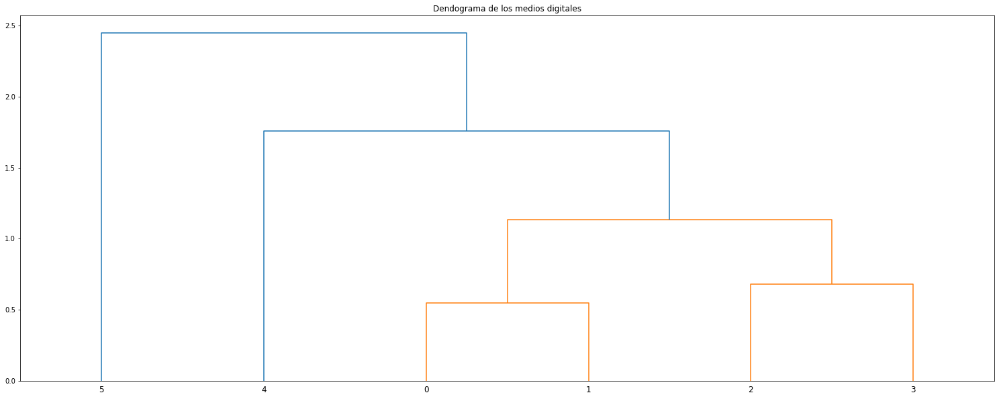

In [138]:
plt.figure(figsize=(26,10))
plt.title('Dendograma de los medios digitales')
dendrogram(d)
plt.show

In [139]:
from sklearn.cluster import KMeans
from sklearn import datasets

In [140]:
model = KMeans(n_clusters=3)

In [141]:
model.fit(df_data_cluster_norm)

C:\Users\ADMIN\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning:

KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.



KMeans(n_clusters=3)

In [142]:
model.labels_

array([0, 0, 0, 0, 2, 1])

In [143]:
md_k = pd.Series(model.labels_)

In [146]:
df_data_cluster_norm['Cluster'] = md_k

In [147]:
df_data_cluster_norm

,medio_digital,bounces,sessionDuration,pageviews,sessions,users,pageviewsPerSession,uniquePageviews,Cluster
medio_digital,,,,,,,,,
1,0.0,0.345346,0.211984,0.215307,0.475849,0.586149,0.718750,0.181241,0.0
2,0.2,0.558134,0.030207,0.481508,0.393849,0.500943,0.677210,0.490339,0.0
3,0.4,0.387330,0.418769,0.280653,0.153978,0.130209,0.931015,0.248843,0.0
4,0.6,0.253810,0.000000,0.000000,0.000000,0.000000,0.707608,0.000000,2.0
5,0.8,0.000000,0.909942,0.023341,0.561749,0.762823,0.000000,0.009136,1.0
6,1.0,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,NaN
